In [9]:
import soundfile as sf
from faster_whisper import WhisperModel
import librosa
import numpy as np
from tqdm.notebook import tqdm
from silero_vad import load_silero_vad, read_audio, get_speech_timestamps
from IPython.display import Audio, display
import noisereduce as nr
import pandas as pd

In [2]:
model_size = "medium.en"
model = WhisperModel(model_size)

[2024-09-18 19:28:21.680] [ctranslate2] [thread 4828233] [warning] The compute type inferred from the saved model is float16, but the target device or backend do not support efficient float16 computation. The model weights have been automatically converted to use the float32 compute type instead.


In [3]:
vad_model = load_silero_vad()

In [4]:
sr_16k = 16_000

In [5]:
# audio, sr = sf.read("test.wav")
# audio, sr = sf.read("test-noise_reduced.wav")
# audio, sr = sf.read("bahrain-ham-noise_reduced.wav")
audio, sr = sf.read("bahrain-ham.wav")
# audio_16k, sr_16k = sf.read("bahrain-ham-16k-noise_reduced.wav")

audio = np.transpose(audio)
# audio_16k = np.transpose(audio_16k)

audio_16k = librosa.resample(audio, orig_sr=sr, target_sr=16_000)
sr = 16_000

# audio_16k = audio.copy()
# sr = 16_000

audio_16k = audio_16k.mean(0)
audio_16k = np.float32(audio_16k)

audio_16k.shape, sr

((122449920,), 16000)

In [6]:
speech_timestamps = get_speech_timestamps(audio_16k, vad_model, min_silence_duration_ms=1000)
len(speech_timestamps)

144

In [8]:
# prompt = "Transcribe Formula 1 team radio communications with a focus on understanding fast speech, technical terminology, and managing background noise from engines and crowd sounds. Ensure accurate transcription of short, rapid exchanges between drivers and engineers."

prompt = "This is an audio transcription of Formula 1 team radio communications. It may contain technical racing terms, driver and team names, and track-specific vocabulary. Background noise and accents may be present. Please transcribe accurately, paying attention to: Driver and engineer names, Car parts and setup terms, Racing strategy terminology, Track names and corner numbers, Tire compound names, Safety car and flag status updates, Transcribe number values precisely and maintain original phrasing where possible. All sentences might not be grammatically accurate."
prompt += "Here are some terms that might come up: Pee-As-tree, Norris, Leclerc, Hulkenberg, strat, turn, Perez, Sainz, Zhou"

# prompt = "Leclerc, Norris, P-As-Tree, Hulkerberg, turn, P-1, P-2."

In [10]:
def seconds2minutes(s):
    return f"{int(s)//60}:{int(s)%60}"

data = []

for speech_segment in tqdm(speech_timestamps):
    print(seconds2minutes(speech_segment["start"]/sr_16k) , seconds2minutes(speech_segment["end"]/sr_16k))
    
    segment_audio = audio_16k[speech_segment["start"]-100: speech_segment["end"]+100]
    
    # segments, info = model.transcribe(segment_audio, beam_size=10, initial_prompt=prompt)
    # transcript = "".join(map(lambda x: x.text, segments))
    # print(transcript)
    # display(Audio(data=segment_audio, rate=sr_16k))
    
    segment_audio = nr.reduce_noise(y=segment_audio, sr=sr_16k)
    segments, info = model.transcribe(segment_audio, beam_size=10, initial_prompt=prompt)
    transcript = "".join(map(lambda x: x.text, segments))
    print(transcript)
    display(Audio(data=segment_audio, rate=sr_16k))
    
    print("-"*50)

    data.append((speech_segment["start"]/sr_16k, speech_segment["end"]/sr_16k, transcript))


  0%|          | 0/144 [00:00<?, ?it/s]

0:1 0:3



--------------------------------------------------
0:5 0:7
 etc.


--------------------------------------------------
0:8 0:13
 Yeah, I would suggest going to MIG2, especially based on those.


--------------------------------------------------
0:43 0:46
 It's okay once the tire temps are in the window.


--------------------------------------------------
2:24 2:28
 and the other car quite a bit further forward on the long run.


--------------------------------------------------
2:32 2:35
 and negative run in the same place that you run your FB2


--------------------------------------------------
4:8 4:9
 Limiter enable please.


--------------------------------------------------
4:16 4:18
 60 seconds,


--------------------------------------------------
4:24 4:25
 and strip 1.


--------------------------------------------------
4:28 4:29
 45 seconds


--------------------------------------------------
4:42 4:44
 30 seconds, single byte point find


--------------------------------------------------
4:57 4:59
 15 seconds


--------------------------------------------------
5:7 5:8
 or 5.


--------------------------------------------------
8:30 8:32
 and last car approaching the grid.


--------------------------------------------------
9:46 9:48
 and Sainz.


--------------------------------------------------
10:24 10:27
 Sainz 0.6 ahead of Max and 0.7 behind


--------------------------------------------------
11:27 11:28
 2.6 behind.


--------------------------------------------------
12:4 12:7
 Sainz 0.8 head, Max and 0.7 behind.


--------------------------------------------------
12:10 12:11
 This has been enabled.


--------------------------------------------------
13:4 13:7
 Perez is now far behind at 1.8 seconds.


--------------------------------------------------
13:43 13:46
 Free position, four.


--------------------------------------------------
15:23 15:24
 Still at 1.8 behind.


--------------------------------------------------
17:1 17:2
 and Perez 1.7.


--------------------------------------------------
17:9 17:10
 Copy


--------------------------------------------------
18:43 18:44
 1.4


--------------------------------------------------
18:45 18:47
 and Strat 11 available if you need to.


--------------------------------------------------
19:41 19:42
 and Perez behind at point 9.


--------------------------------------------------
20:20 20:21
 Point A.


--------------------------------------------------
23:41 23:41
 Switch.


--------------------------------------------------
25:8 25:12
 So the next couple of times is George at 3.1. Yep, probably that last one.


--------------------------------------------------
26:21 26:23
 Give us a balance check. Balance check.


--------------------------------------------------
26:54 26:56
 Chris, Box-Box, Box-Box


--------------------------------------------------
27:19 27:23
 so we'll go strat mode 4, strat mode 4, tag 2.5


--------------------------------------------------
27:31 27:32
 and Merritt.


--------------------------------------------------
27:34 27:38
 traffic with Zhou, Zhou car behind, Valshi car ahead.


--------------------------------------------------
30:10 30:11
 and about strat mode 11.


--------------------------------------------------
30:47 30:49
 Fisk, HPP9, position 3


--------------------------------------------------
31:22 31:22
 and front runners, yes.


--------------------------------------------------
32:14 32:15
 Stop so it's starting to happen now.


--------------------------------------------------
32:49 32:52
 Two seconds outside our window is 40.0


--------------------------------------------------
33:30 33:31
 and Split that tag too.


--------------------------------------------------
33:51 33:52
 and something like that.


--------------------------------------------------
36:7 36:9
 and George at 7.7 behind.


--------------------------------------------------
37:22 37:25
 Just think about delaying the short shift from 1-2


--------------------------------------------------
37:26 37:27
 helping the surgeons.


--------------------------------------------------
38:26 38:33
 Looks like the medium tire has a better pace for racing.


--------------------------------------------------
38:49 38:53
 George on the hard time, Four laps year. Four laps year for George.


--------------------------------------------------
39:51 39:52
 and George entry bits and sell.


--------------------------------------------------
42:24 42:25
 38 1


--------------------------------------------------
43:19 43:25
 The main loss is turn 2-3.Turns 2-3 and turns 13.


--------------------------------------------------
45:23 45:25
 Balance check, Balance check


--------------------------------------------------
46:0 46:3
 and Lewis. Last up George has a 38.6


--------------------------------------------------
47:15 47:16
 Going off on a defensive entry.


--------------------------------------------------
47:19 47:19
 and Ventric.


--------------------------------------------------
47:38 47:40
 and 38-9.


--------------------------------------------------
49:17 49:18
 George, 39th Street


--------------------------------------------------
50:33 50:35
 this in your safety car and VSC.


--------------------------------------------------
50:55 50:56
 George, same lap time.


--------------------------------------------------
52:35 52:36
 39-3


--------------------------------------------------
53:39 53:41
 Box, box, box, box.


--------------------------------------------------
53:42 53:47
 I'm going to switch to sound 3, this is a slow tire.


--------------------------------------------------
54:10 54:14
 and Lewis. Important that we don't push this tire too hard on the out lap.


--------------------------------------------------
54:16 54:17
 Bring it in nice and steady.


--------------------------------------------------
54:23 54:25
 or behind at 6 seconds.


--------------------------------------------------
55:18 55:24
 Fastly ahead after 5.5 seconds, 39.9 on medium time, 14 laps.


--------------------------------------------------
55:40 55:44
 Think about bringing back brake, turn 14, maximising mid-exit.


--------------------------------------------------
57:20 57:23
 It is for now Lewis, just whilst we bring the tire in then we'll need to pick it up.


--------------------------------------------------
57:37 57:39
 What are you doing? 39.7


--------------------------------------------------
57:53 57:55
 Sandboat 3, Sandboat 3


--------------------------------------------------
59:14 59:15
 Stabilised,


--------------------------------------------------
60:10 60:12
 and Anderson at 3.9.


--------------------------------------------------
60:13 60:14
 17. Hold soft time.


--------------------------------------------------
62:48 62:53
 Target lap time, mid 36, that wheel drop off, about 2 tenths a lap.


--------------------------------------------------
65:3 65:8
 Medium tires, 16 seconds behind, Sam 2


--------------------------------------------------
65:47 65:47
 Coffee.


--------------------------------------------------
66:3 66:4
 at turn 4.


--------------------------------------------------
67:17 67:21
 Chassis equals 42 Chassis equals 42


--------------------------------------------------
68:43 68:46
 to menu 2, take us out of the default region.


--------------------------------------------------
70:55 71:5
 George doing 37.7 at the moment. He's on 6 lap pressure, medium tires. He's at 37.2


--------------------------------------------------
71:21 71:23
 and be safe to magnificent by 8 seconds.


--------------------------------------------------
71:39 71:39
 and Coppi.


--------------------------------------------------
73:51 73:53
 X7-7, 15 seconds behind


--------------------------------------------------
73:54 73:56
 Give us a balance check when you can.


--------------------------------------------------
75:27 75:28
 Here are some terms that might come up.


--------------------------------------------------
78:48 78:48
 38-0


--------------------------------------------------
81:49 81:50
 and Hulkenberg.


--------------------------------------------------
81:57 81:58
 and Nathan.


--------------------------------------------------
82:23 82:23
 Clear on exit.


--------------------------------------------------
82:46 82:49
 12 laps are when you cross the line 12 laps.


--------------------------------------------------
83:22 83:26
 HPP1, position 14, 1, position 14


--------------------------------------------------
83:33 83:35
 VSC, VSC that's positive.


--------------------------------------------------
83:43 83:44
 Just stay on the delta.


--------------------------------------------------
83:51 83:54
 Keep your eye on the filter. Safety car, safety car.


--------------------------------------------------
83:56 83:57
 Stateouts and Stateouts.


--------------------------------------------------
84:12 84:13
 Okay, starting posture.


--------------------------------------------------
84:30 84:30
 and Postive.


--------------------------------------------------
84:42 84:44
 They only need to go by the safety car.


--------------------------------------------------
84:47 84:50
 Keep on that delta.


--------------------------------------------------
84:55 84:56
 and SQL for the safety car.


--------------------------------------------------
84:57 85:0
 You should not pass for the signal.


--------------------------------------------------
85:4 85:5
 Stay on that delta.


--------------------------------------------------
85:55 85:58
 and Delta.


--------------------------------------------------
86:29 86:31
 Now you've moved out and you're safe to come.


--------------------------------------------------
86:49 86:51
 Past one season, follow the delta.


--------------------------------------------------
86:56 86:58
 and no overtaking.


--------------------------------------------------
87:9 87:10
 stuffs ahead.


--------------------------------------------------
87:16 87:17
 It's a bad mark, can't it?


--------------------------------------------------
87:20 87:23
 P5, George P6


--------------------------------------------------
87:26 87:29
 It'll probably take a while to sort all this out once I go and save the car.


--------------------------------------------------
88:17 88:20
 Carl who should pick up the pace once he's crossed the centre of the line again.


--------------------------------------------------
88:23 88:26
 Safety car can't be between 3 and 4.


--------------------------------------------------
88:34 88:35
 If you get to recover that car.


--------------------------------------------------
88:41 88:43
 to get a bit of break temperature.


--------------------------------------------------
88:53 88:57
 This is a break attempt for you, just have a little bit of a spit on the rabbit and come together now.


--------------------------------------------------
89:3 89:5
 Maintaining a bit of bulk temp.


--------------------------------------------------
89:27 89:32
 So everyone is on similar H tyres, they're all on 3-core lap-hold soft tyres.


--------------------------------------------------
89:52 89:53
 Safety car now.


--------------------------------------------------
90:4 90:6
 He's yet to fall and 9 laps can cross the line.


--------------------------------------------------
90:59 90:59
 All types look good.


--------------------------------------------------
91:28 91:32
 failed line, lapsed cars are now allowed to be overtaken.


--------------------------------------------------
92:0 92:1
 Be good.


--------------------------------------------------
92:14 92:15
 now in order.


--------------------------------------------------
92:28 92:30
 Still a bit large and hard of brakes.


--------------------------------------------------
92:31 92:36
 Perez and Sainz.


--------------------------------------------------
93:10 93:12
 Yes, that's not massive.


--------------------------------------------------
93:14 93:16
 and safety guards moving in just now.


--------------------------------------------------
93:19 93:20
 and 7 racing laps.


--------------------------------------------------
94:32 94:34
 and then you have overtake away.


--------------------------------------------------
94:38 94:38
 and Trowell.


--------------------------------------------------
98:31 98:33
 has been enabled, Perez 0.9 ahead.


--------------------------------------------------
101:12 101:12
 and


--------------------------------------------------
103:0 103:2
 Three position two. Three position two.


--------------------------------------------------
103:5 103:7
 and Perez may be used now too.


--------------------------------------------------
104:14 104:15
 and Perez look through for comment.


--------------------------------------------------
104:38 104:39
 One more lap and cross the line.


--------------------------------------------------
106:30 106:33
 Beautiful work, Lewis.


--------------------------------------------------
106:41 106:43
 Guys, mega, mega joke.


--------------------------------------------------
106:45 106:49
 Thanks so much for the hard work. Appreciate it.


--------------------------------------------------
106:52 106:58
 Let's go strat 1, yeah, it's a long way to go but not a sweet start.


--------------------------------------------------
107:34 107:35
 What happened to two cars?


--------------------------------------------------
107:37 107:42
 We think let's stop an issue with the system. Perez, not sure what happened to him.


--------------------------------------------------
108:45 108:47
 So you'll be coming into the pit lane.


--------------------------------------------------
109:17 109:20
 Great work this weekend mate. See you up there.


--------------------------------------------------
109:25 109:26
 Rough when you can.


--------------------------------------------------


In [ ]:
df = pd.DataFrame(data, columns=["start", "end", "text"])
print(len(df))
df.head()

# VAD

In [21]:
from silero_vad import load_silero_vad, read_audio, get_speech_timestamps
from IPython.display import Audio, display
import pandas as pd

In [2]:
model = load_silero_vad()

In [3]:
wav = read_audio('bahrain-ham.wav') # backend (sox, soundfile, or ffmpeg) required!

In [16]:
%%time
speech_timestamps = get_speech_timestamps(wav, model, min_silence_duration_ms=1000)
len(speech_timestamps)

In [17]:
len(speech_timestamps)

132

In [15]:
get_speech_timestamps?

Signature:
get_speech_timestamps(
    audio: torch.Tensor,
    model,
    threshold: float = 0.5,
    sampling_rate: int = 16000,
    min_speech_duration_ms: int = 250,
    max_speech_duration_s: float = inf,
    min_silence_duration_ms: int = 100,
    speech_pad_ms: int = 30,
    return_seconds: bool = False,
    visualize_probs: bool = False,
    progress_tracking_callback: Callable[[float], NoneType] = None,
    window_size_samples: int = 512,
)
Docstring:
This method is used for splitting long audios into speech chunks using silero VAD

Parameters
----------
audio: torch.Tensor, one dimensional
    One dimensional float torch.Tensor, other types are casted to torch if possible

model: preloaded .jit/.onnx silero VAD model

threshold: float (default - 0.5)
    Speech threshold. Silero VAD outputs speech probabilities for each audio chunk, probabilities ABOVE this value are considered as SPEECH.
    It is better to tune this parameter for each dataset separately, but "lazy" 0.5 is pr

<Axes: >

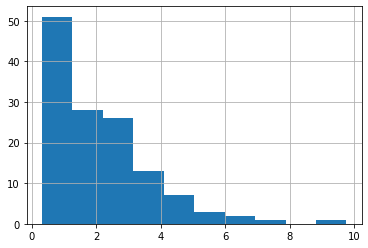

In [23]:
pd.Series([(x["end"] - x["start"])/16_000 for x in speech_timestamps]).hist()

In [19]:
for x in speech_timestamps:
    print(x["start"]/16_000, x["end"]/16_000)
    display(Audio(data=wav[int(x["start"]):int(x["end"])], rate=16_000))

1.762 3.038


5.794 7.006


8.13 13.342


42.978 46.334


144.354 148.766


152.002 155.454


248.162 249.47


256.898 258.142


264.994 265.694


268.066 269.438


282.114 284.958


297.474 299.102


307.522 308.03


510.946 512.062


586.466 588.158


624.322 627.006


687.394 688.478


724.706 727.55


730.146 731.102


784.834 787.294


823.234 826.014


923.458 924.638


1021.442 1022.686


1123.65 1124.286


1125.666 1127.134


1181.09 1182.91


1220.642 1221.118


1421.442 1421.854


1508.226 1512.926


1581.73 1583.358


1614.818 1616.67


1639.618 1643.582


1651.874 1652.19


1654.338 1655.838


1656.962 1658.782


1810.69 1811.902


1847.682 1849.886


1934.21 1935.422


1969.058 1972.414


2010.53 2011.326


2167.298 2169.694


2242.466 2245.406


2246.754 2247.614


2306.466 2313.31


2329.986 2333.598


2391.394 2392.542


2544.802 2545.694


2599.042 2605.406


2724.098 2725.086


2760.77 2763.518


2858.594 2860.094


2957.506 2958.654


3033.954 3035.39


3055.458 3056.51


3219.778 3227.166


3250.818 3254.078


3256.194 3257.214


3263.618 3265.278


3318.53 3324.222


3340.45 3344.382


3440.354 3443.07


3457.986 3459.582


3473.794 3475.742


3554.146 3555.998


3610.946 3612.094


3613.634 3614.846


3768.546 3773.214


3903.554 3908.286


3963.906 3964.542


4037.986 4041.694


4122.978 4126.59


4255.458 4265.214


4281.442 4283.838


4299.49 4299.934


4431.01 4433.566


4434.946 4436.222


4909.762 4910.366


4943.458 4943.806


4966.914 4969.502


5002.786 5006.27


5013.57 5015.902


5023.906 5024.958


5031.874 5034.846


5036.194 5037.438


5070.082 5070.558


5082.274 5084.958


5087.682 5090.398


5095.394 5096.446


5097.506 5100.446


5104.802 5105.534


5155.106 5158.11


5189.282 5191.55


5209.314 5210.59


5216.834 5218.078


5229.762 5230.526


5236.322 5237.63


5240.866 5243.87


5246.306 5249.246


5297.346 5300.638


5303.714 5306.846


5314.594 5315.838


5321.73 5323.486


5333.954 5337.566


5343.81 5345.822


5367.714 5371.838


5392.834 5393.406


5404.034 5406.11


5459.138 5459.55


5488.546 5489.662


5492.034 5492.446


5534.946 5535.518


5548.706 5549.886


5551.394 5555.998


5590.818 5592.894


5594.722 5595.998


5599.394 5600.574


5672.546 5674.11


5911.682 5913.342


6072.482 6072.862


6180.482 6182.75


6186.082 6187.006


6254.562 6255.582


6278.466 6279.646


6390.018 6393.438


6402.05 6403.678


6405.954 6409.022


6412.418 6418.078


6454.53 6455.71


6457.762 6462.654


6525.89 6527.102


6557.602 6560.03


6565.826 6566.526


In [12]:
df = pd.DataFrame(data, columns=["start", "end", "text"])
print(len(df))
df.head()

144


,start,end,text
0,1.762,3.038,
1,5.890,7.006,etc.
2,8.130,13.342,"Yeah, I would suggest going to MIG2, especial..."
3,43.106,46.334,It's okay once the tire temps are in the window.
4,144.258,148.766,and the other car quite a bit further forward...


In [13]:
df.to_csv("bahrain-ham.csv", index=False)

In [10]:
[(x["end"]-x["start"])/16_000 for x in speech_timestamps]

[0.54,
 0.412,
 1.212,
 0.38,
 1.532,
 1.852,
 1.244,
 1.148,
 0.54,
 1.852,
 0.924,
 0.604,
 0.444,
 0.796,
 2.364,
 1.308,
 1.244,
 0.7,
 1.372,
 2.844,
 1.34,
 0.508,
 1.116,
 0.476,
 0.316,
 0.412,
 0.732,
 0.38,
 0.796,
 0.348,
 0.476,
 1.084,
 0.636,
 1.052,
 0.7,
 0.316,
 1.18,
 1.052,
 0.38,
 0.636,
 0.7,
 0.988,
 0.412,
 0.796,
 0.38,
 0.604,
 1.02,
 0.348,
 1.5,
 1.628,
 0.348,
 0.38,
 0.508,
 0.316,
 0.54,
 0.316,
 0.348,
 1.148,
 0.412,
 0.764,
 0.668,
 0.444,
 0.764,
 2.076,
 1.02,
 0.956,
 1.532,
 0.316,
 0.86,
 1.244,
 1.788,
 1.02,
 0.54,
 1.98,
 1.084,
 0.476,
 0.348,
 1.66,
 1.372,
 1.788,
 0.892,
 2.076,
 0.572,
 1.148,
 0.508,
 0.828,
 0.668,
 1.916,
 1.084,
 0.636,
 2.332,
 3.26,
 0.7,
 1.18,
 0.764,
 0.956,
 1.82,
 2.236,
 2.172,
 0.412,
 1.34,
 0.924,
 0.764,
 0.636,
 0.38,
 0.796,
 0.7,
 0.412,
 0.764,
 0.668,
 0.7,
 0.892,
 0.988,
 0.348,
 0.508,
 0.572,
 0.348,
 0.348,
 1.084,
 0.508,
 1.276,
 1.052,
 0.476,
 1.02,
 1.212,
 1.052,
 0.764,
 0.796,
 0.444,
 0.79